In [1]:
# Load necessary libraries
import sys
import os
import anndata as ad
import pandas as pd
import scanpy as sc
import seaborn as sns; sns.set(color_codes=True)

# Import Scimap
import scimap as sm

In [2]:
# Set the working directory
os.chdir ("/home/josenimo/DVP")

In [3]:
!ls

README.txt	      TMA_01_data	 figures
TMA_01_Core_01.ipynb  csv_to_figures.py  scimap_env.txt


In [4]:
# Load data
adata = sm.pp.mcmicro_to_scimap ("./TMA_01_data/unmicst-TMA_01_Core_06_cell.csv")

Loading unmicst-TMA_01_Core_06_cell.csv


In [5]:
adata

AnnData object with n_obs × n_vars = 14658 × 12
    obs: 'X_centroid', 'Y_centroid', 'Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity', 'Solidity', 'Extent', 'Orientation', 'imageid'
    uns: 'all_markers'

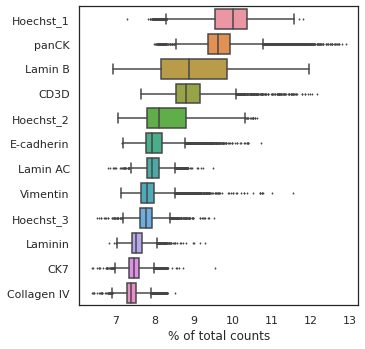

In [6]:
sc.pl.highest_expr_genes(adata, n_top=20, save="TMA_01_Core_06_bargraph")

In [7]:
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=2)

/home/josenimo/anaconda3/envs/scimap/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html



In [8]:
sc.tl.umap(adata)

In [9]:
sc.set_figure_params(scanpy=True, dpi=200, dpi_save=500, frameon=True, 
                                vector_friendly=True, fontsize=14, figsize=(6,6), 
                                color_map='viridis_r', format='pdf', facecolor=None, 
                                transparent=False, ipython_format='png2x')

/home/josenimo/anaconda3/envs/scimap/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning:

The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.

... storing 'imageid' as categorical


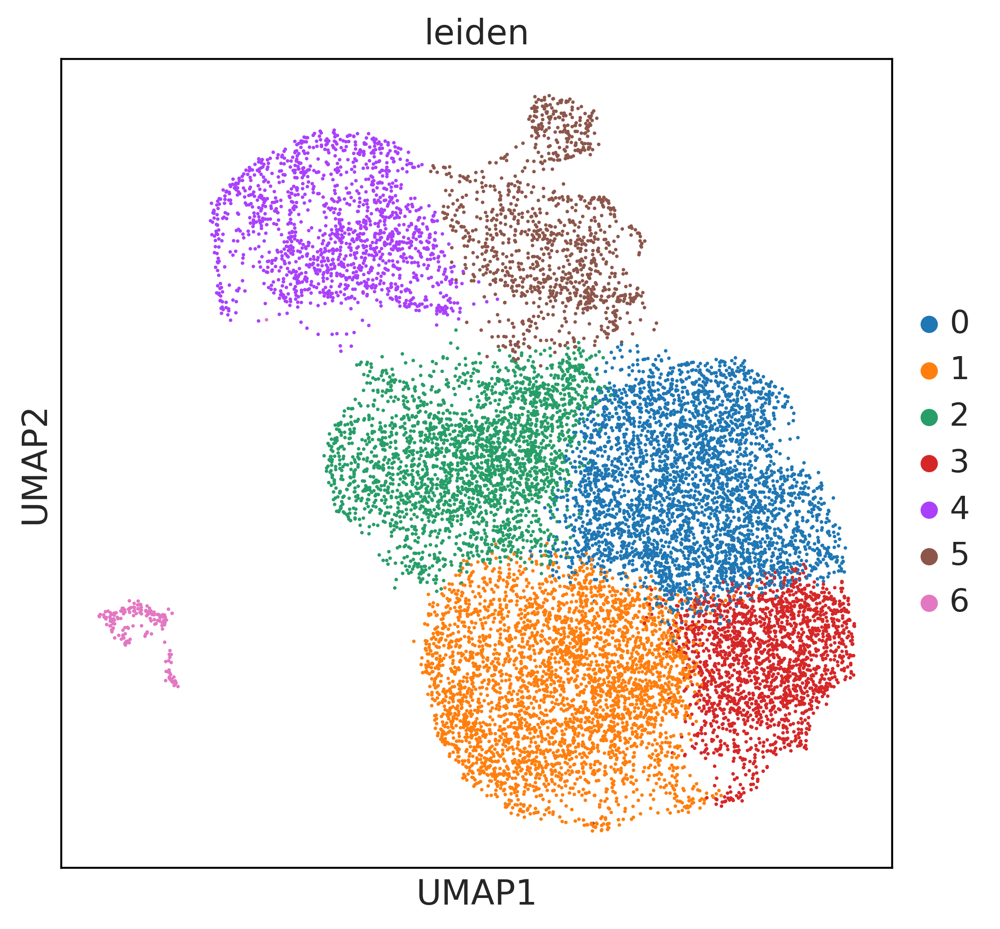

In [10]:
sc.tl.leiden(adata, resolution = 0.3)
sc.pl.umap(adata, color='leiden', save='TMA_01_Core_06_leiden_0.3')

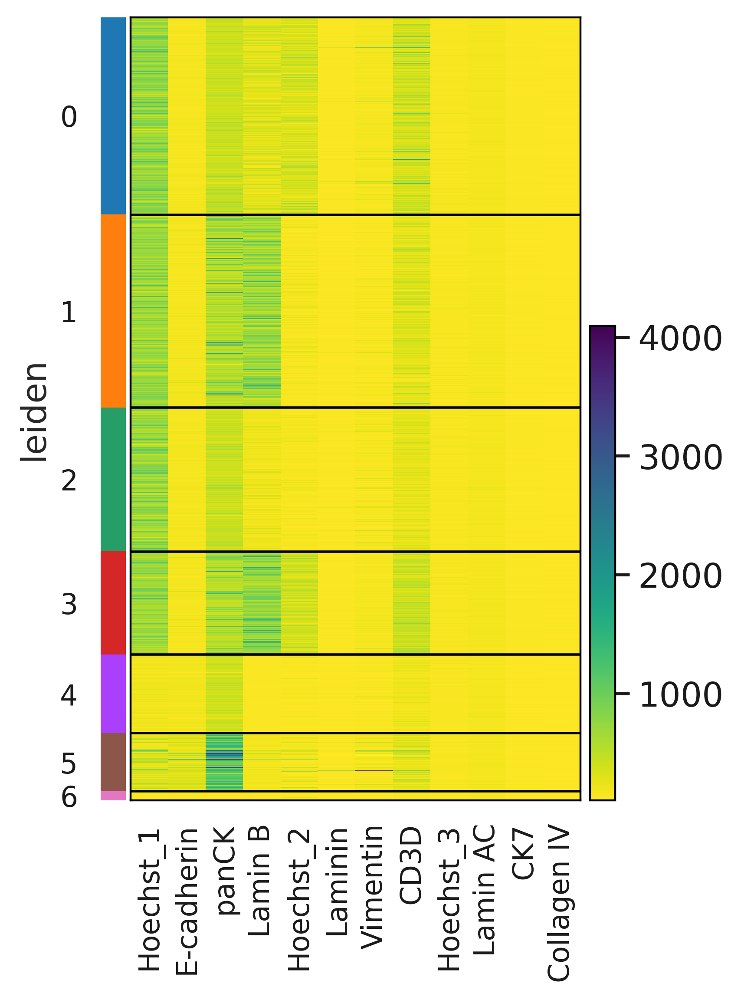

In [11]:
sc.pl.heatmap(adata, adata.var_names, groupby='leiden', save="TMA_01_Core_06")

In [12]:
#sc.pl.matrixplot(adata, adata.var_names, groupby='leiden', dendrogram=True)

In [13]:
#sc.pl.dotplot(adata, adata.var_names, groupby='leiden', dendrogram=True)

In [14]:
#sc.set_figure_params(dpi=300, color_map = 'viridis_r', figsize=(10,10))
#sc.pl.scatter(adata, x='X_centroid', y='Y_centroid', color='leiden')

In [15]:
#sc.set_figure_params(dpi=500, color_map = 'viridis_r', figsize=(10,10))
#sc.pl.scatter(adata, x='X_centroid', y='Y_centroid', color='leiden')

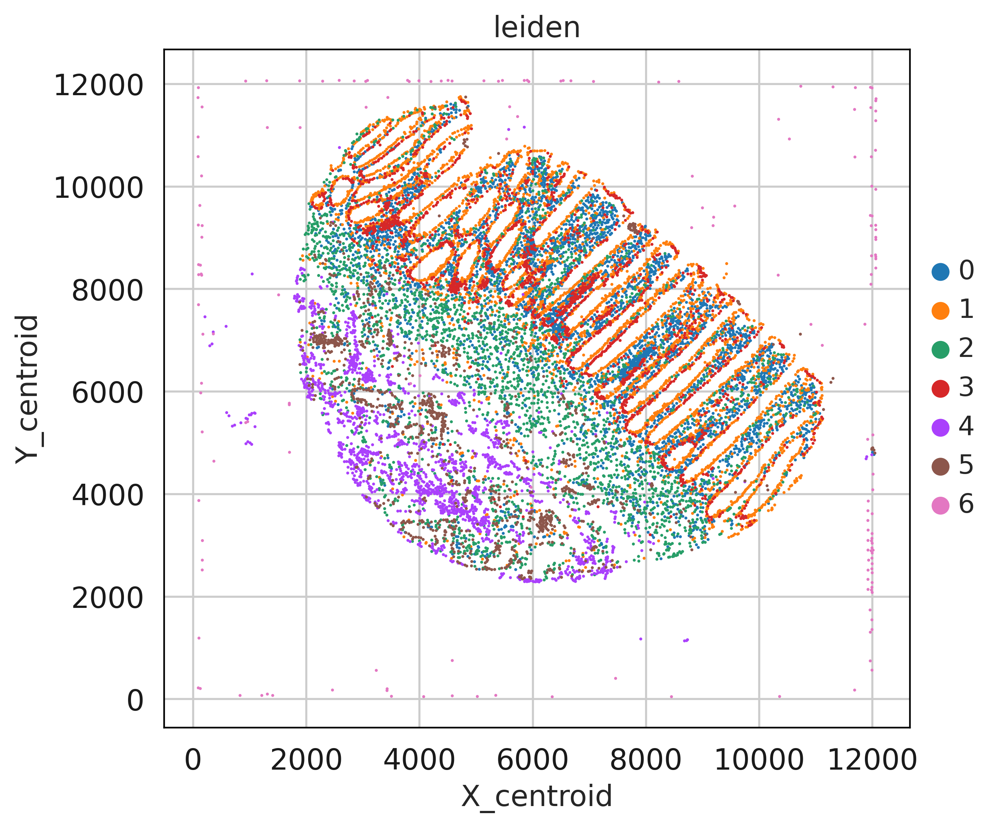

In [16]:
#sc.set_figure_params(dpi=500, color_map = 'viridis_r', figsize=(6,6))
sc.pl.scatter(adata, x='X_centroid', y='Y_centroid', color='leiden', save="leidencolor_TMA_01_Core_06")

In [17]:
#sc.set_figure_params(dpi=500, color_map = 'viridis_r', figsize=(6,6))
#sc.pl.scatter(adata, x='X_centroid', y='Y_centroid', color='CD3D')

In [18]:
#sc.pl.scatter(adata, x='X_centroid', y='Y_centroid', color='CD3D', save=True)

In [19]:
from matplotlib.pyplot import rc_context

In [20]:
with rc_context({'figure.figsize': (6,6)}):
    sc.pl.umap(adata, color=adata.var_names, save="TMA_01_Core_06_grid")